### Important Libraries

In [1]:
import pandas as pd
print(pd.__version__)
import numpy as np
print(np.__version__)
import matplotlib.pyplot as plt
import seaborn as sns
import xgboost as xg
from sklearn.svm import OneClassSVM
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error as MSE
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import confusion_matrix, accuracy_score
from sklearn.inspection import permutation_importance

2.0.2
1.23.5


In [2]:
# check xgboost version
data_path = "..\Data\Depletion.csv"
df = pd.read_csv(data_path)
print("\nLoaded Data :", data_path, "\n----------------------------------------------")
print("\n","\n",df.head())
# thres = 1000


Loaded Data : ..\Data\Depletion.csv 
----------------------------------------------

 
    WELL    WELL_1  mTVDSS  Northing    Easting  \
0   107  Raag-107  2550.4  839440.1  2516323.0   
1   107  Raag-107  2550.5  839440.1  2516323.0   
2   107  Raag-107  2550.7  839440.2  2516323.0   
3   107  Raag-107  2550.8  839440.2  2516323.0   
4   107  Raag-107  2551.0  839440.2  2516323.0   

   ANGLE_FAIL.DEG                  :  Fail Angle  \
0                                         34.140   
1                                         33.889   
2                                         33.504   
3                                         33.074   
4                                         32.755   

   BRIT_IND.                     :  Brittleness Index  \
0                                             38.377    
1                                             38.336    
2                                             38.968    
3                                             39.797    
4           

### Visualizing Dataset

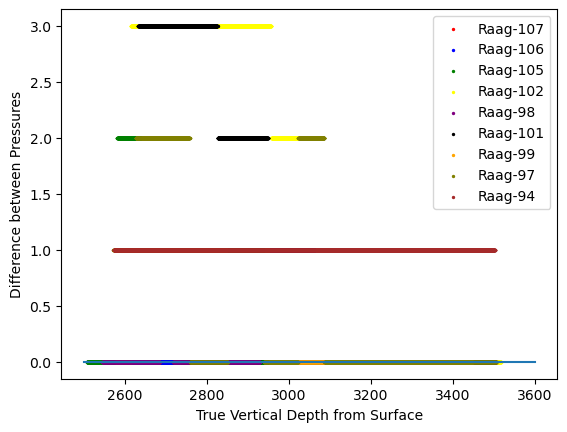

In [3]:
well_name = [[2,6027],[6028,12053],[12054,18102],[18103,24277],[24278,30679],[30680,36398],[36399,42150],[42511,48286],[48287,54487]]#[[2,119],[120,213],[214,330],[331,445],[446,581]]
diff_list = []
color_l = ['red','blue','green','yellow', 'purple', 'black', 'orange', 'olive', 'brown']#['red','blue','green','yellow','black']
well = ['Raag-107','Raag-106','Raag-105','Raag-102','Raag-98','Raag-101','Raag-99','Raag-97','Raag-94']#['Raag-105','Raag-106','Raag-107','Raag-98','Raag-94']
i=0
for start,end in well_name:
    diff, depth = df.iloc[start-1:end,-1], df.iloc[start-1:end,2]
    new_diff = [depth, diff, color_l[i], well[i]]
    diff_list.append(new_diff)
    i+=1
for depth, diff, color_n, well in diff_list:
    plt.scatter(depth, diff, color = color_n, s=2, label = well)
    plt.xlabel('True Vertical Depth from Surface')
    plt.ylabel('Difference between Pressures')
x = [2500,3600]
y = [0,0]
plt.plot(x,y)
plt.legend()

In [ ]:
# press_diff = []
# i = 0  
# j = 0
# for check in df['PRESS_PP.PSI                  :  Pore Pressure']-df['Well Block Pressure (psi)']:
#     if(check>thres):
#         press_diff.append(1)
#         i+=1
#     else:
#         press_diff.append(0)
#         j+=1
# print(press_diff)
# print('number of Depleted', i)
# print('number of Normal Zones', j)
# df.drop(['Well Block Pressure (psi)'], axis=1)
# df['Depletion'] = press_diff

In [4]:
df = df.iloc[:,2:]
df.head(20)

,mTVDSS,Northing,Easting,ANGLE_FAIL.DEG : Fail Angle,BRIT_IND. : Brittleness Index,BRIT_PR. : Brittleness Index from Poisson's Ratio,BRIT_YM. : Brittleness Index from Young's Modulus,CS .M/MIN : Compressive Strength,DTCO .US/F : Compressional slowness,DTSM .US/F : Fast Shear Slowness,...,STRESS_CUM.PSI : Cumulative stress (SHPZ),UCS_BF.PSI : Uniaxial Compressive Strength (BF),UCS_LAL.PSI : Uniaxial Compressive Strength (lal),VP .FT/S : Compressional velocity,VPVS . : Vp / Vs ratio,VS .FT/S : Shear velocity,YM . : Youngs' Modulus,YM_STAT. : Youngs' Modulus (Static),PRESS_PP.PSI : Pore Pressure,Depetion
0,2550.4,839440.1,2516323.0,34.140,38.377,39.566,37.188,983.446,85.666,155.296,...,10745.905,1530.737,3710.090,11673.283,1.813,6439.337,3.603,2.014,4970.330,0
1,2550.5,839440.1,2516323.0,33.889,38.336,40.276,36.395,974.222,86.574,156.413,...,10491.886,1508.828,3655.972,11550.865,1.807,6393.318,3.548,1.977,4970.452,0
2,2550.7,839440.2,2516323.0,33.504,38.968,42.315,35.621,960.112,87.987,157.473,...,10292.826,1487.513,3573.973,11365.380,1.790,6350.295,3.493,1.941,4970.574,0
3,2550.8,839440.2,2516323.0,33.074,39.797,44.944,34.649,944.563,89.578,158.458,...,10117.524,1460.926,3484.724,11163.493,1.769,6310.816,3.425,1.897,4970.696,0
4,2551.0,839440.2,2516323.0,32.755,40.163,46.596,33.731,933.105,90.774,159.441,...,9955.089,1435.945,3419.701,11016.407,1.756,6271.913,3.361,1.855,4970.817,0
5,2551.1,839440.2,2516322.9,32.688,39.466,45.778,33.155,930.681,91.029,160.448,...,9929.674,1420.350,3406.021,10985.462,1.763,6232.542,3.321,1.829,4970.939,0
6,2551.3,839440.3,2516322.9,32.826,37.863,42.931,32.796,935.633,90.508,161.536,...,10053.362,1410.650,3433.992,11048.734,1.785,6190.582,3.296,1.812,4971.061,0
7,2551.4,839440.3,2516322.9,32.932,36.443,40.412,32.474,939.460,90.108,162.695,...,10167.068,1401.976,3455.686,11097.806,1.806,6146.466,3.273,1.798,4971.182,0
8,2551.6,839440.3,2516322.9,32.815,35.914,39.962,31.867,935.237,90.550,163.840,...,10218.961,1385.669,3431.749,11043.659,1.809,6103.523,3.231,1.770,4971.304,0
9,2551.7,839440.3,2516322.9,32.501,36.130,41.199,31.061,924.010,91.738,165.030,...,10230.164,1364.135,3368.530,10900.655,1.799,6059.493,3.174,1.734,4971.426,0


In [7]:
df = df.drop(['Northing', 'Easting'], axis=1)

In [8]:
df = df.drop(['PRESS_PP.PSI                  :  Pore Pressure'], axis = 1)
display(df)

,mTVDSS,ANGLE_FAIL.DEG : Fail Angle,BRIT_IND. : Brittleness Index,BRIT_PR. : Brittleness Index from Poisson's Ratio,BRIT_YM. : Brittleness Index from Young's Modulus,CS .M/MIN : Compressive Strength,DTCO .US/F : Compressional slowness,DTSM .US/F : Fast Shear Slowness,IP .RAYL/M2 : P Impedence,IS .RAYL/M2 : S Impedance,...,SHMIN_GRAD. : Horizontal Stress Gradient (Min),STRESS_CUM.PSI : Cumulative stress (SHPZ),UCS_BF.PSI : Uniaxial Compressive Strength (BF),UCS_LAL.PSI : Uniaxial Compressive Strength (lal),VP .FT/S : Compressional velocity,VPVS . : Vp / Vs ratio,VS .FT/S : Shear velocity,YM . : Youngs' Modulus,YM_STAT. : Youngs' Modulus (Static),Depetion
0,2550.400000,34.140,38.377,39.566,37.188,983.446,85.666,155.296,8953.927,4939.257,...,1.685,10745.905,1530.737,3710.090,11673.283,1.813,6439.337,3.603,2.014,0
1,2550.500000,33.889,38.336,40.276,36.395,974.222,86.574,156.413,8864.428,4906.395,...,1.681,10491.886,1508.828,3655.972,11550.865,1.807,6393.318,3.548,1.977,0
2,2550.700000,33.504,38.968,42.315,35.621,960.112,87.987,157.473,8747.370,4887.507,...,1.670,10292.826,1487.513,3573.973,11365.380,1.790,6350.295,3.493,1.941,0
3,2550.800000,33.074,39.797,44.944,34.649,944.563,89.578,158.458,8583.651,4852.410,...,1.657,10117.524,1460.926,3484.724,11163.493,1.769,6310.816,3.425,1.897,0
4,2551.000000,32.755,40.163,46.596,33.731,933.105,90.774,159.441,8448.126,4809.727,...,1.648,9955.089,1435.945,3419.701,11016.407,1.756,6271.913,3.361,1.855,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
54481,3502.113404,42.066,79.902,67.003,92.801,1308.967,NaN,NaN,11333.843,6947.807,...,1.367,12916.122,3336.842,5889.145,16602.435,1.631,10177.530,7.496,5.044,1
54482,3502.262878,42.824,80.627,62.584,98.670,1344.206,NaN,NaN,11735.920,7093.019,...,1.393,13248.333,3558.334,6157.085,17208.533,1.655,10400.585,7.907,5.416,1
54483,3502.413336,44.056,80.688,53.675,107.700,1403.336,NaN,NaN,12447.493,7289.937,...,1.448,13795.492,3910.611,6621.038,18258.019,1.708,10692.901,8.539,6.007,1
54484,3502.562810,45.066,78.615,44.104,113.127,1453.720,NaN,NaN,13075.070,7364.313,...,1.510,14412.490,4129.017,7030.621,19184.523,1.776,10805.358,8.919,6.374,1


In [9]:
df_max_scaled = df.copy()
i = 0  
# apply normalization techniques
for column in df_max_scaled.iloc[:,:-1].columns:
        df_max_scaled[column] = df_max_scaled[column]  / df_max_scaled[column].abs().max()
      
# ## view normalized data
display(df_max_scaled)

,mTVDSS,ANGLE_FAIL.DEG : Fail Angle,BRIT_IND. : Brittleness Index,BRIT_PR. : Brittleness Index from Poisson's Ratio,BRIT_YM. : Brittleness Index from Young's Modulus,CS .M/MIN : Compressive Strength,DTCO .US/F : Compressional slowness,DTSM .US/F : Fast Shear Slowness,IP .RAYL/M2 : P Impedence,IS .RAYL/M2 : S Impedance,...,SHMIN_GRAD. : Horizontal Stress Gradient (Min),STRESS_CUM.PSI : Cumulative stress (SHPZ),UCS_BF.PSI : Uniaxial Compressive Strength (BF),UCS_LAL.PSI : Uniaxial Compressive Strength (lal),VP .FT/S : Compressional velocity,VPVS . : Vp / Vs ratio,VS .FT/S : Shear velocity,YM . : Youngs' Modulus,YM_STAT. : Youngs' Modulus (Static),Depetion
0,0.725009,0.034166,0.038406,0.335766,0.037216,0.610207,0.085730,0.567426,0.444112,0.456809,...,0.001686,0.588645,0.191434,0.441660,0.523868,0.669004,0.515452,0.003606,0.002016,0
1,0.725037,0.033914,0.038365,0.341791,0.036422,0.604484,0.086639,0.571507,0.439673,0.453769,...,0.001682,0.574730,0.188694,0.435218,0.518374,0.666790,0.511768,0.003551,0.001978,0
2,0.725094,0.033529,0.038997,0.359095,0.035648,0.595729,0.088053,0.575380,0.433867,0.452022,...,0.001671,0.563826,0.186028,0.425456,0.510050,0.660517,0.508325,0.003496,0.001942,0
3,0.725122,0.033099,0.039827,0.381405,0.034675,0.586081,0.089645,0.578979,0.425746,0.448776,...,0.001658,0.554223,0.182703,0.414832,0.500990,0.652768,0.505164,0.003428,0.001898,0
4,0.725179,0.032780,0.040193,0.395424,0.033756,0.578972,0.090842,0.582571,0.419024,0.444829,...,0.001649,0.545325,0.179579,0.407091,0.494389,0.647970,0.502050,0.003364,0.001856,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
54481,0.995555,0.042098,0.079962,0.568603,0.092871,0.812186,NaN,NaN,0.562155,0.642570,...,0.001368,0.707526,0.417305,0.701061,0.745076,0.601845,0.814685,0.007502,0.005048,1
54482,0.995597,0.042856,0.080688,0.531102,0.098744,0.834051,NaN,NaN,0.582098,0.656000,...,0.001394,0.725724,0.445005,0.732958,0.772276,0.610701,0.832540,0.007913,0.005420,1
54483,0.995640,0.044089,0.080749,0.455498,0.107781,0.870740,NaN,NaN,0.617391,0.674212,...,0.001449,0.755697,0.489061,0.788188,0.819374,0.630258,0.855939,0.008545,0.006012,1
54484,0.995682,0.045100,0.078674,0.374277,0.113212,0.902002,NaN,NaN,0.648519,0.681090,...,0.001511,0.789495,0.516375,0.836946,0.860953,0.655351,0.864941,0.008926,0.006379,1


### Visualizing Data

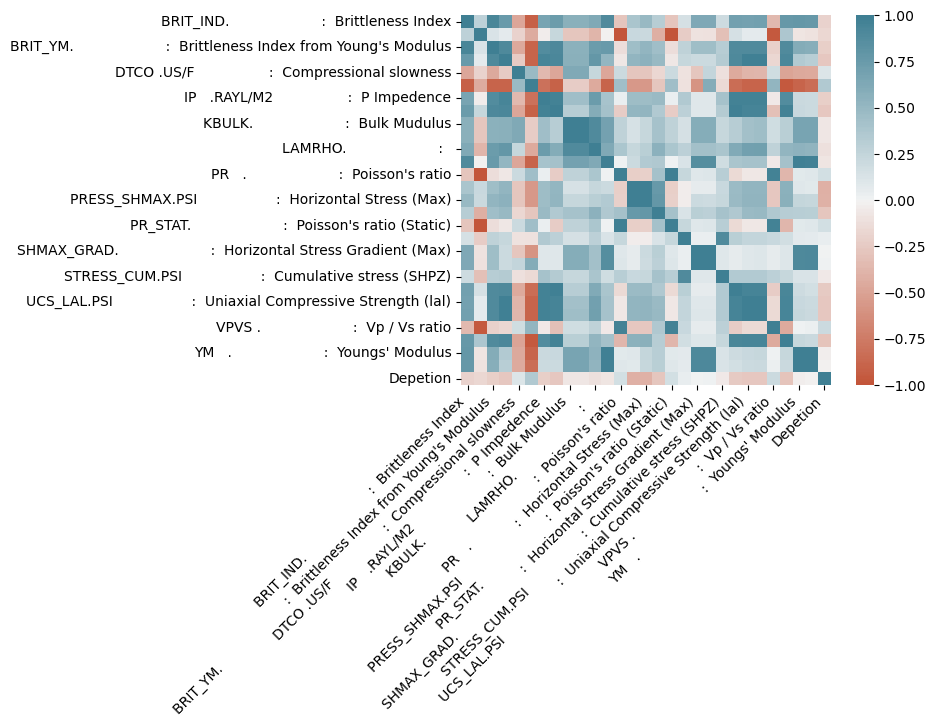

In [10]:
data = df_max_scaled.iloc[:,2:]
corr = data.corr()
ax = sns.heatmap(
    corr, 
    vmin=-1, vmax=1, center=0,
    cmap=sns.diverging_palette(20, 220, n=200),
    square=True
)
ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation=45,
    horizontalalignment='right'
);

In [11]:
depleted_0 = len(df_max_scaled[df_max_scaled.Depetion == 0])
depleted_1 = len(df_max_scaled[df_max_scaled.Depetion == 1])
depleted_2 = len(df_max_scaled[df_max_scaled.Depetion == 2])
depleted_3 = len(df_max_scaled[df_max_scaled.Depetion == 3])
print(depleted_0, "\n", depleted_1, "\n", depleted_2,"\n", depleted_3, "\n")

35929 
 11262 
 3142 
 4153 



In [12]:
# number of fraud cases
depleted = len(df_max_scaled[df_max_scaled.Depetion == 2])
# selecting the indices of the non-fraud classes
depleted_0_indices = df_max_scaled[df_max_scaled.Depetion == 0].index
depleted_1_indices = df_max_scaled[df_max_scaled.Depetion == 1].index
depleted_2_indices = df_max_scaled[df_max_scaled.Depetion == 2].index
depleted_3_indices = df_max_scaled[df_max_scaled.Depetion == 3].index
# from all non-fraud observations, randomly select observations equal to number of fraud observations
random_depleted_0_indices = np.random.choice(depleted_0_indices, depleted, replace = False)
random_depleted_1_indices = np.random.choice(depleted_1_indices, depleted, replace = False)
random_depleted_3_indices = np.random.choice(depleted_3_indices, depleted, replace = False)
depleted_indices = np.concatenate([random_depleted_0_indices, random_depleted_1_indices, random_depleted_3_indices])
random_non_depleted_indices = np.array(depleted_indices)
# appending the 2 indices
under_sample_indices = np.concatenate([depleted_2_indices,random_non_depleted_indices])
# undersample dataset
under_sample_data = df_max_scaled.iloc[under_sample_indices,1:]
# now split X, y variables from the under sample data
X_undersample = under_sample_data.loc[:, under_sample_data.columns != 'Depetion']
y_undersample = under_sample_data.loc[:, under_sample_data.columns == 'Depetion']
display(X_undersample)
y_undersample

,ANGLE_FAIL.DEG : Fail Angle,BRIT_IND. : Brittleness Index,BRIT_PR. : Brittleness Index from Poisson's Ratio,BRIT_YM. : Brittleness Index from Young's Modulus,CS .M/MIN : Compressive Strength,DTCO .US/F : Compressional slowness,DTSM .US/F : Fast Shear Slowness,IP .RAYL/M2 : P Impedence,IS .RAYL/M2 : S Impedance,KBULK. : Bulk Mudulus,...,SHMAX_GRAD. : Horizontal Stress Gradient (Max),SHMIN_GRAD. : Horizontal Stress Gradient (Min),STRESS_CUM.PSI : Cumulative stress (SHPZ),UCS_BF.PSI : Uniaxial Compressive Strength (BF),UCS_LAL.PSI : Uniaxial Compressive Strength (lal),VP .FT/S : Compressional velocity,VPVS . : Vp / Vs ratio,VS .FT/S : Shear velocity,YM . : Youngs' Modulus,YM_STAT. : Youngs' Modulus (Static)
12538,0.030709,0.020112,0.181351,0.018838,0.534031,0.098896,0.726361,0.389212,0.360768,0.012250,...,0.002438,0.001792,0.567678,0.131385,0.359878,0.454127,0.742435,0.402664,0.002320,0.001209
12539,0.030900,0.027730,0.274258,0.023118,0.538103,0.098130,0.673976,0.390950,0.387521,0.010661,...,0.002441,0.001729,0.518863,0.144726,0.364034,0.457671,0.694096,0.433962,0.002619,0.001388
12540,0.031496,0.030170,0.294879,0.025566,0.550875,0.095776,0.649330,0.398359,0.400019,0.010750,...,0.002442,0.001715,0.493119,0.152533,0.377227,0.468922,0.685240,0.450434,0.002790,0.001493
12541,0.032066,0.030188,0.286342,0.026608,0.563261,0.093560,0.637675,0.402623,0.402167,0.011284,...,0.002442,0.001721,0.494888,0.155894,0.390250,0.480027,0.688930,0.458667,0.002863,0.001538
12542,0.032600,0.039221,0.395509,0.031801,0.574993,0.091521,0.586901,0.404956,0.429912,0.009577,...,0.002445,0.001653,0.455839,0.172993,0.402791,0.490722,0.647970,0.498347,0.003226,0.001767
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20511,0.043485,0.091838,0.548660,0.118973,0.852574,0.056433,0.338623,0.660413,0.749298,0.018691,...,0.002487,0.001496,0.468634,0.546044,0.760574,0.795826,0.606273,0.863737,0.009329,0.006777
18591,0.028791,0.008672,0.071793,0.008877,0.494101,0.106817,0.871009,0.352167,0.294025,0.012155,...,0.002441,0.001866,0.693895,0.101852,0.320385,0.420449,0.823985,0.335795,0.001622,0.000813
31039,0.043655,0.078459,0.325820,0.118495,0.857647,0.055974,0.372578,0.753923,0.771107,0.033013,...,0.002468,0.001658,0.677515,0.543555,0.768232,0.802357,0.672694,0.785019,0.009295,0.006743
20133,0.042191,0.064455,0.284136,0.095404,0.814837,0.060014,0.409610,0.694140,0.692391,0.030443,...,0.002472,0.001678,0.674840,0.429162,0.704888,0.748339,0.689668,0.714048,0.007679,0.005207


,Depetion
12538,2
12539,2
12540,2
12541,2
12542,2
...,...
20511,3
18591,3
31039,3
20133,3


In [38]:
depleted_indices_sns = np.concatenate([random_depleted_0_indices[::50], random_depleted_1_indices[::50], random_depleted_3_indices[::50]])
random_non_depleted_indices_sns = np.array(depleted_indices_sns)
# appending the 2 indices
under_sample_indices_sns = np.concatenate([depleted_2_indices[::50],random_non_depleted_indices_sns])
# undersample dataset
under_sample_data_sns = df_max_scaled.iloc[under_sample_indices_sns,1:]
under_sample_data_sns

,ANGLE_FAIL.DEG : Fail Angle,BRIT_IND. : Brittleness Index,BRIT_PR. : Brittleness Index from Poisson's Ratio,BRIT_YM. : Brittleness Index from Young's Modulus,CS .M/MIN : Compressive Strength,DTCO .US/F : Compressional slowness,DTSM .US/F : Fast Shear Slowness,IP .RAYL/M2 : P Impedence,IS .RAYL/M2 : S Impedance,KBULK. : Bulk Mudulus,...,SHMIN_GRAD. : Horizontal Stress Gradient (Min),STRESS_CUM.PSI : Cumulative stress (SHPZ),UCS_BF.PSI : Uniaxial Compressive Strength (BF),UCS_LAL.PSI : Uniaxial Compressive Strength (lal),VP .FT/S : Compressional velocity,VPVS . : Vp / Vs ratio,VS .FT/S : Shear velocity,YM . : Youngs' Modulus,YM_STAT. : Youngs' Modulus (Static),Depetion
12538,0.030709,0.020112,0.181351,0.018838,0.534031,0.098896,0.726361,0.389212,0.360768,0.012250,...,0.001792,0.567678,0.131385,0.359878,0.454127,0.742435,0.402664,0.002320,0.001209,2
12588,0.031008,0.017464,0.143205,0.018041,0.540410,0.097699,0.741363,0.396545,0.355770,0.013414,...,0.001818,0.667107,0.128944,0.366399,0.459688,0.766790,0.394517,0.002264,0.001176,2
12638,0.033459,0.030090,0.241535,0.031697,0.594154,0.088310,0.619961,0.447883,0.434339,0.014328,...,0.001748,0.668333,0.172643,0.423712,0.508563,0.709594,0.471773,0.003219,0.001763,2
12688,0.032781,0.030059,0.262538,0.029157,0.578992,0.090838,0.628686,0.425438,0.418494,0.012781,...,0.001733,0.631507,0.164214,0.407112,0.494407,0.699631,0.465223,0.003041,0.001650,2
12738,0.031151,0.021325,0.185933,0.020725,0.543474,0.097131,0.710773,0.401546,0.373576,0.012776,...,0.001785,0.679634,0.137216,0.369553,0.462378,0.739483,0.411496,0.002452,0.001287,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30680,0.037426,0.049913,0.357168,0.057706,0.687989,0.074515,0.487425,0.530140,0.551753,0.016503,...,0.001644,0.632557,0.266895,0.534117,0.602712,0.661255,0.600052,0.005040,0.003028,3
20288,0.040809,0.061435,0.329945,0.083961,0.776201,0.064002,0.425011,0.635586,0.651611,0.024166,...,0.001641,0.577482,0.376700,0.650210,0.701712,0.671218,0.688173,0.006878,0.004503,3
18552,0.030364,0.014459,0.121243,0.014620,0.526750,0.100284,0.776703,0.377004,0.331390,0.012854,...,0.001828,0.718766,0.118620,0.352506,0.447840,0.782657,0.376566,0.002025,0.001038,3
13399,0.042776,0.069044,0.279019,0.105183,0.831698,0.058378,0.399730,0.739149,0.734905,0.033613,...,0.001707,0.685209,0.476215,0.729488,0.769317,0.691882,0.731693,0.008363,0.005839,3


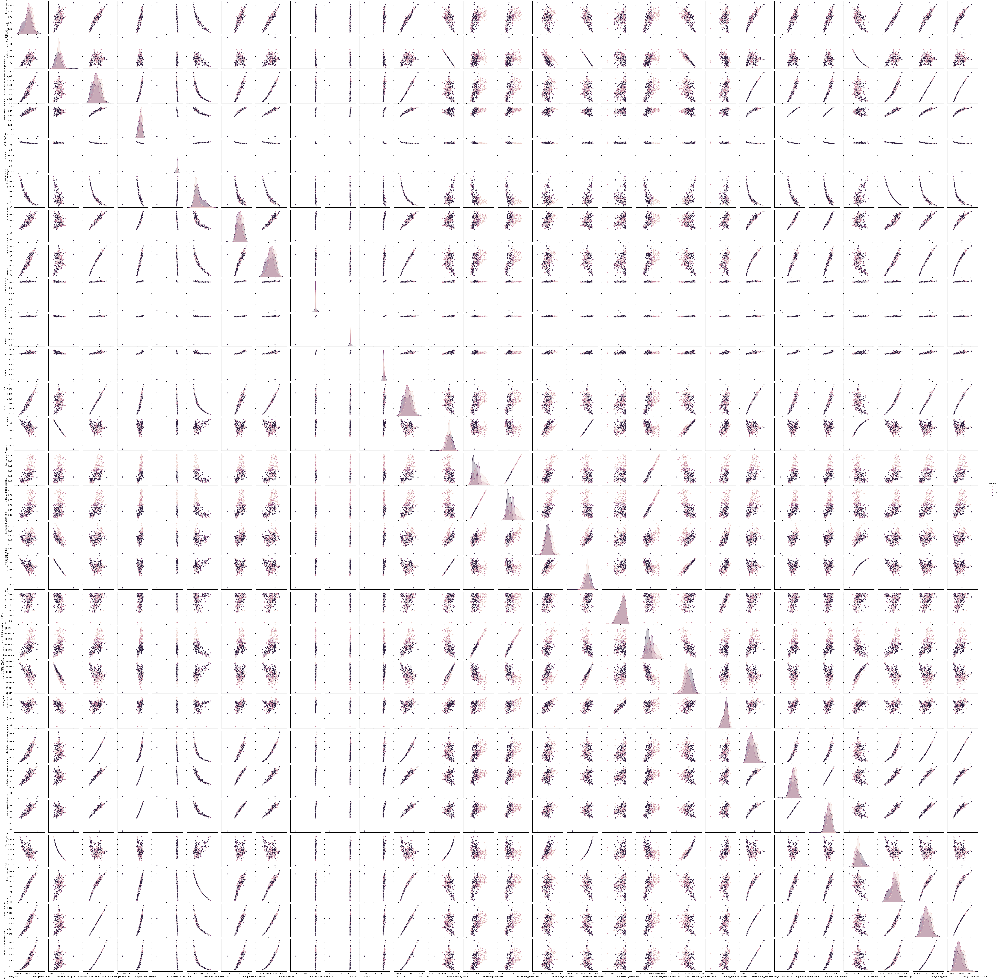

In [40]:
df_sns = under_sample_data_sns
sns.pairplot(data=df_sns, hue='Depetion')

In [13]:
train_X, test_X, train_y, test_y = train_test_split(X_undersample, y_undersample,
                      test_size = 0.2, random_state = 123)
print("\n", train_X.head(), "\n", test_X.head(), "\n\n\n", train_y.head(), "\n", test_y.head())


        ANGLE_FAIL.DEG                  :  Fail Angle  \
50895                                       0.042920   
53504                                       0.039997   
32156                                       0.037790   
30522                                       0.041975   
43011                                       0.035404   

       BRIT_IND.                     :  Brittleness Index  \
50895                                           0.084078    
53504                                           0.056553    
32156                                           0.056126    
30522                                           0.070747    
43011                                           0.048864    

       BRIT_PR.                     :  Brittleness Index from Poisson's Ratio  \
50895                                           0.465164                        
53504                                           0.288455                        
32156                                           0.4

In [ ]:
# train_dmatrix = xg.DMatrix(data = train_X, label = train_y)
# test_dmatrix = xg.DMatrix(data = test_X, label = test_y)

In [22]:
# Define the hyperparameter grid
param_grid = {
    'max_depth': [3, 5, 7],
    'learning_rate': [0.1, 0.01, 0.001],
    'subsample': [0.5, 0.7, 1]
}

# Create the XGBoost model object
xgb_model = xg.XGBClassifier()

# Create the GridSearchCV object
grid_search = GridSearchCV(xgb_model, param_grid, cv=5, scoring='accuracy', verbose = 2)

# Fit the GridSearchCV object to the training data
grid_search.fit(train_X, train_y)

# Print the best set of hyperparameters and the corresponding score
print("Best set of hyperparameters: ", grid_search.best_params_)
print("Best score: ", grid_search.best_score_)

Fitting 5 folds for each of 27 candidates, totalling 135 fits
[CV] END ......learning_rate=0.1, max_depth=3, subsample=0.5; total time=   1.9s
[CV] END ......learning_rate=0.1, max_depth=3, subsample=0.5; total time=   1.7s
[CV] END ......learning_rate=0.1, max_depth=3, subsample=0.5; total time=   1.8s
[CV] END ......learning_rate=0.1, max_depth=3, subsample=0.5; total time=   1.8s
[CV] END ......learning_rate=0.1, max_depth=3, subsample=0.5; total time=   1.8s


KeyboardInterrupt: 

In [24]:
xgb_model = xg.XGBClassifier(learning_rate = 0.1, max_depth = 7, subsample = 0.7)
xgb_model.fit(train_X, train_y)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.1, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=7, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=100, n_jobs=None, num_parallel_tree=None,
              objective='multi:softprob', predictor=None, ...)

In [25]:
pred = xgb_model.predict(test_X)
accuracy = accuracy_score(test_y, pred)
accuracy

0.8520286396181385

In [26]:
pred_train = xgb_model.predict(train_X)
accuracy = accuracy_score(train_y, pred_train)
accuracy

0.9532524368410583

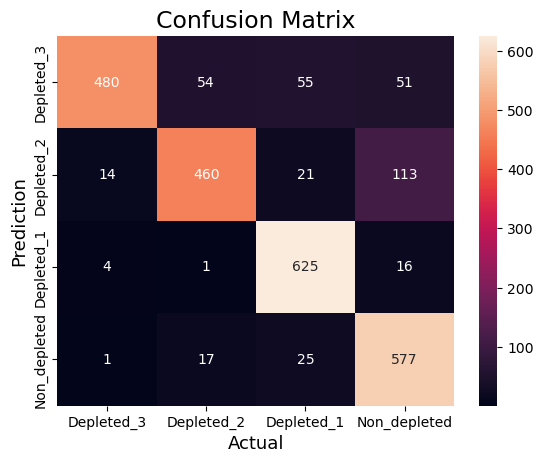

In [27]:
cm = confusion_matrix(test_y,pred)
 
#Plot the confusion matrix.
sns.heatmap(cm,
            annot=True,
            fmt='g',
            xticklabels=['Depleted_3','Depleted_2','Depleted_1','Non_depleted'],
            yticklabels=['Depleted_3','Depleted_2','Depleted_1','Non_depleted'])
plt.ylabel('Prediction',fontsize=13)
plt.xlabel('Actual',fontsize=13)
plt.title('Confusion Matrix',fontsize=17)
plt.show()

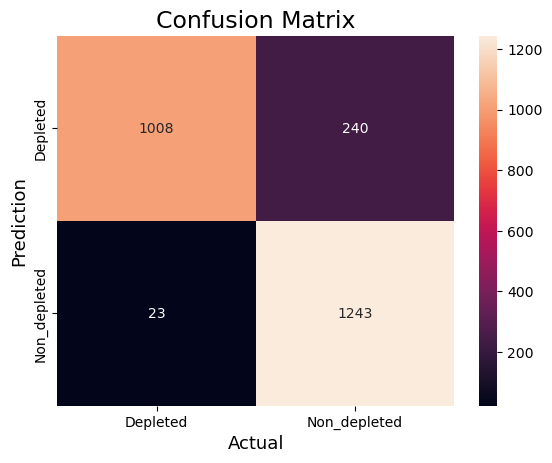

In [28]:
new_confusion_matrix = [[cm[0,0]+cm[0,1]+cm[1,0]+cm[1,1], cm[0,2]+cm[0,3]+cm[1,2]+cm[1,3]], [cm[2,0]+cm[3,0]+cm[2,1]+cm[3,1], cm[2,2]+cm[2,3]+cm[3,2]+cm[3,3]]]
sns.heatmap(new_confusion_matrix,
            annot=True,
            fmt='g',
            xticklabels=['Depleted','Non_depleted'],
            yticklabels=['Depleted','Non_depleted'])
plt.ylabel('Prediction',fontsize=13)
plt.xlabel('Actual',fontsize=13)
plt.title('Confusion Matrix',fontsize=17)
plt.show()

In [29]:
confusion_matrix(test_y,pred)

array([[480,  54,  55,  51],
       [ 14, 460,  21, 113],
       [  4,   1, 625,  16],
       [  1,  17,  25, 577]], dtype=int64)

In [30]:
from sklearn.metrics import classification_report
print(classification_report(test_y,pred))

              precision    recall  f1-score   support

           0       0.96      0.75      0.84       640
           1       0.86      0.76      0.81       608
           2       0.86      0.97      0.91       646
           3       0.76      0.93      0.84       620

    accuracy                           0.85      2514
   macro avg       0.86      0.85      0.85      2514
weighted avg       0.86      0.85      0.85      2514



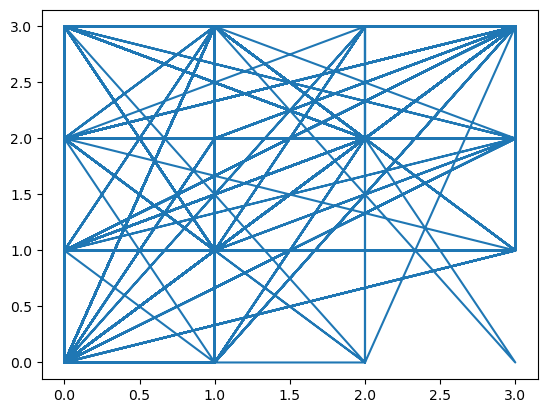

In [21]:
plt.plot(test_y, pred)

In [31]:
xgb_model.get_booster().get_score(importance_type="gain")
# xgb_model.feature_importances_

{'ANGLE_FAIL.DEG                  :  Fail Angle': 1.7596139907836914,
 'BRIT_IND.                     :  Brittleness Index': 2.2197530269622803,
 "BRIT_PR.                     :  Brittleness Index from Poisson's Ratio": 2.343339681625366,
 "BRIT_YM.                     :  Brittleness Index from Young's Modulus": 2.6122615337371826,
 'CS   .M/MIN                 :  Compressive Strength': 1.9341977834701538,
 'DTCO .US/F                 :  Compressional slowness': 21.706674575805664,
 'DTSM .US/F                 :  Fast Shear Slowness': 5.887261867523193,
 'IP   .RAYL/M2                 :  P Impedence': 2.4283230304718018,
 'IS   .RAYL/M2                 :  S Impedance': 2.9143917560577393,
 'KBULK.                     :  Bulk Mudulus': 1.8977888822555542,
 'LAMRHO.                     :  ': 2.537569761276245,
 'MU   .CP                   :  Mu': 2.489659309387207,
 'PRESS_OB.PSI                  :  Over-burden Pressure': 9.489884376525879,
 'PRESS_SHMAX.PSI                  :  Horizonta

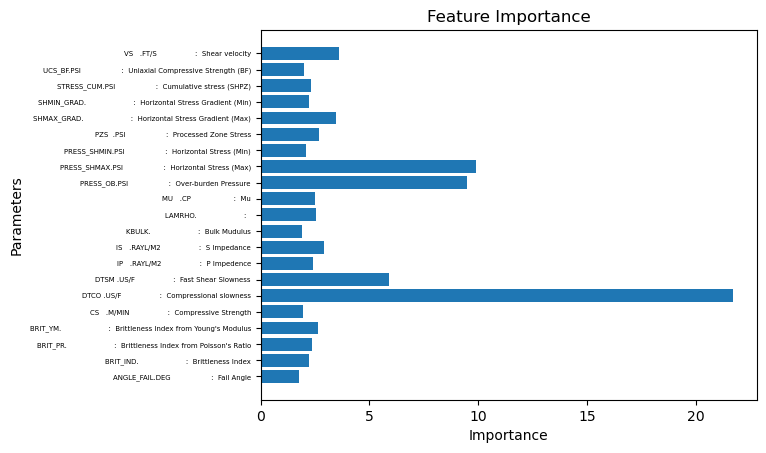

In [32]:
feature_importance = xgb_model.get_booster().get_score(importance_type="gain")
# list_features = ['mTVDSS','Northing', 'Easting','ANGLE_FAIL.DEG                  :  Fail Angle','BRIT_IND.                     :  Brittleness Index','BRIT_PR.                     :  Brittleness Index from Poisson\'s Ratio', 'BRIT_YM.                     :  Brittleness Index from Young\'s Modulus','CS   .M/MIN                 :  Compressive Strength','DTCO .US/F                 :  Compressional slowness','DTSM .US/F                 :  Fast Shear Slowness','IP   .RAYL/M2                 :  P Impedence','IS   .RAYL/M2                 :  S Impedance','KBULK.                     :  Bulk Mudulus','LAMBDA.                     :  Lambda','LAMRHO.                     :  ','MU   .CP                   :  Mu','PR   .                     :  Poisson\'s ratio','PRESS_OB.PSI                  :  Over-burden Pressure','PRESS_SHMAX.PSI                  :  Horizontal Stress (Max)','PRESS_SHMIN.PSI                  :  Horizontal Stress (Min)','PR_STAT.                     :  Poisson\'s ratio (Static)','PZS  .PSI                  :  Processed Zone Stress','SHMAX_GRAD.                     :  Horizontal Stress Gradient (Max)','SHMIN_GRAD.                     :  Horizontal Stress Gradient (Min)','STRESS_CUM.PSI                  :  Cumulative stress (SHPZ)','UCS_BF.PSI                  :  Uniaxial Compressive Strength (BF)','UCS_LAL.PSI                  :  Uniaxial Compressive Strength (lal)','VP   .FT/S                 :  Compressional velocity','VPVS .                     :  Vp / Vs ratio','VS   .FT/S                 :  Shear velocity','YM   .                     :  Youngs\' Modulus','YM_STAT.                     :  Youngs\' Modulus (Static)', 'PRESS_PP.PSI                  :  Pore Pressure']
 
# getting values against each value of y
# x=list(feature_importance)
# plt.barh(list_features, x)
y=list(feature_importance.keys())
 
# getting values against each value of y
x=list(feature_importance.values())
plt.barh(y, x)
# setting label of y-axis
plt.ylabel("Parameters")
plt.yticks(fontsize = 5) 
# setting label of x-axis
plt.xlabel("Importance")
plt.title("Feature Importance")
plt.show()

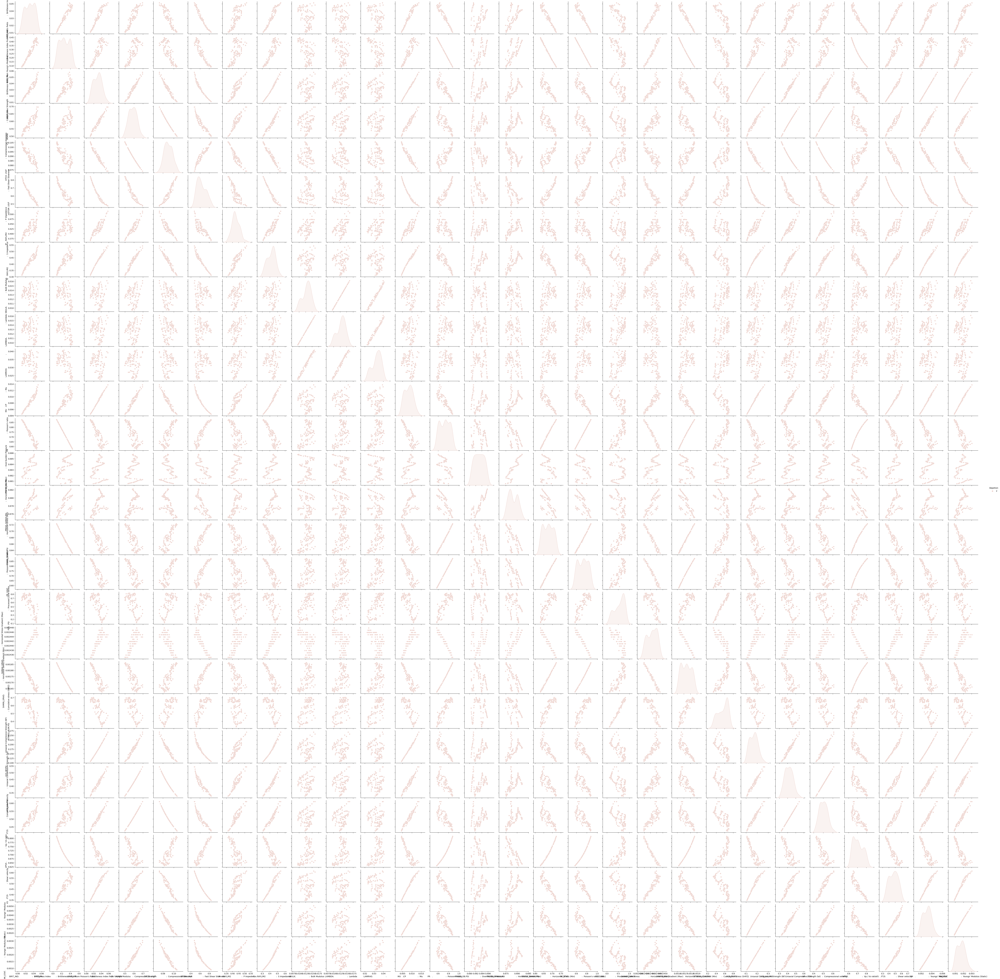

In [33]:
df_sns = under_sample_data.iloc[:120, 1:]
sns.pairplot(data=df_sns, hue='Depetion')